## Graphene/BN stack diffusion simulation

### Potential Surface

First we define the potential energy surface described for a graphene/hBN stack as described by the section **Parametrization of potential energy** of *Origin of band gaps in graphene on hexagonal boron nitride* (Jung et. al.)

Potential can be written as (eq. 28):

$$\Phi(x, y, C_0, C_1, \phi) = C_0 + 2C_1 \cos(\phi-G_1y) + 4C_1 \cos(G_1y/2 + \phi)\cos(\sqrt{3}G_1x / 2)$$

In [21]:
import numpy as np
import matplotlib.pyplot as plt

lattice_constant_mismatch = 0.03
lattice_angle_mismtach = 0 * np.pi / 180 # degrees to radians
# Moire superlattice wavelength, in units of graphene lattice constant length
# lm = (lattice_constant_mismatch ** 2 + lattice_angle_mismtach ** 2) ** (-1/2)
lm = 45
G1 = 4 * np.pi / (np.sqrt(3) * lm)
# G1 = 2e-1

f1 = lambda x, y, C1, phi: 2 * C1 * np.cos(phi - G1 * y) \
    + 4 * C1 * np.cos(G1 * y/2 + phi) * np.cos(np.sqrt(3)*G1 * x /2)

def Phi(C0, C1, phi):
    """
    Returns a function U(x, y) that evaluates to Phi(x, y; C0, C1, phi)
    Lattice constant defaults to graphene lattice constant in nanometers (nm)
    """
    return lambda x, y : C0 + f1(x, y, C1, phi)

# Define constants
M0, tau, D0, T0, T1, phi = 0.0 6975, 7, 3.46, -10.44, -58.87, 50.4 / 180 * np.pi
M = lambda x : -M0 * (1 + tau * x) * np.exp(-tau * x)
T = lambda x : T0 / (x ** 4 + T1)
W = lambda x : (1 + np.exp(-16 * (x - 4))) ** -1
C0 = lambda z : (M(z / D0 - 1) + (T(z) - M(z / D0 - 1)) * W(z))
z = 3.4 # Angstroms
C0 = C0(z)

a, b, z0  = 2.226, 3.295, 1.295
z = 3.4 # Angstroms
C1 = lambda z : a * np.exp(-b * (z - z0))
C1 = C1(z)

Uc = Phi(C0 / 2, C1, phi)
print("Moire lattice constant lm = {}".format(lm))
print("Moire reciprocaal lattice constant G1 = {}".format(G1))

Moire lattice constant lm = 45
Moire reciprocaal lattice constant G1 = 0.16122661015415268


<a list of 70 text.Text objects>

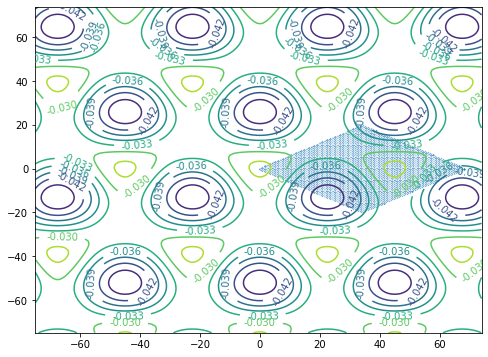

In [22]:
import seaborn as sns
lattice = []
atom_a = np.array([0, 0])
atom_b = np.array([1/np.sqrt(3), 0])
a1 = np.array([np.sqrt(3)/2, 1/2])
a2 = np.array([np.sqrt(3)/2, -1/2])
for i in range(40):
    for j in range(40):
        cell_origin = i * a1 + j * a2
        lattice.append(cell_origin + atom_a)
        lattice.append(cell_origin + atom_b)
lattice = np.array(lattice)
plt.figure(figsize=(8, 6))
ax = sns.scatterplot(lattice[:,0], lattice[:, 1], s=10)
delta = 1
x = np.arange(-75, 75, delta)
y = np.arange(-75, 75, delta)
X, Y = np.meshgrid(x, y)
Z = Uc(X, Y)
CS = ax.contour(X, Y, Z)
ax.clabel(CS, inline=1, fontsize=10)

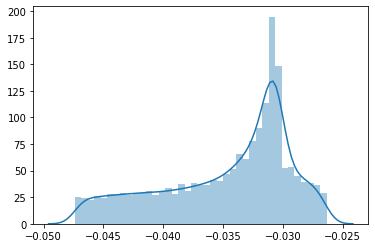

In [23]:
sns.distplot(Z.ravel())

In [24]:
from scipy.interpolate import interp1d
import pandas as pd
def simulate(N=250, num_jumps=10000, temperature=2e-1, trans_energy=0.5, rotate_energy=1, num_pts=None, end_time=100):
    """
    Return dataframe of trajectories with
        N : number of independent single particles
        num_jumps : number of Monte Carlo steps
        end_time : last point in lab-time, wait times are rescaled to fit in this time frame
        num_pts : number of evenly spaced points in time for the actual trajectory
    """
    AB = np.array([1/2, np.sqrt(3) / 2])

    a_transition = np.array([
        AB,
        np.array([-1/2, np.sqrt(3) / 2]),
        np.array([1/2, -np.sqrt(3) / 2]),
        np.array([-1/2, -np.sqrt(3) / 2]),
        np.array([-1, 0]),
        np.array([1, 0])
    ], dtype=np.float64)
    b_transition = np.array([
        np.array([1/4, np.sqrt(3)/4]),
        np.array([-1/4, np.sqrt(3)/4]),
        np.array([1/4, -np.sqrt(3)/4]),
        np.array([-1/4, -np.sqrt(3)/4])
    ], dtype=np.float64)
    deg = lambda degrees : degrees / 180 * np.pi
    r = lambda theta : np.array(( (np.cos(theta), -np.sin(theta)),
                   (np.sin(theta),  np.cos(theta)) ))
    # Randomly distribute N particles
#     initial_positions = np.random.randint(-10, 10, size=(2, N)) # Choose lattice sites
    initial_positions = np.zeros((2, N))
#     x = initial_positions[0, :] * a1[0] + initial_positions[1, :] * a2[0]
#     y = initial_positions[0, :] * a1[1] + initial_positions[1, :] * a2[1]
#     initial_positions = np.array([x, y])
    #rate_a/(rate_a + rate_b)
    rate_a = np.exp(trans_energy / temperature)
    rate_b = np.exp(rotate_energy / temperature)
    
    tracks = np.empty((N, num_jumps + 1, 2))
    tracks[:, 0, :] = initial_positions.T
    
    prob_a = rate_a / (rate_a + rate_b)
    prob_b = rate_b / (rate_a + rate_b)
    
    transitions = [(a_transition, b_transition) for i in range(N)]
    
    ##transition probabilities at each time step for each molecule
    transition_probabilities = np.random.uniform(0, 1, size=(tracks.shape[1], N))
#     a_indices = np.random.randint(6, size=(N, num_jumps))    
#     b_indices = np.random.randint(4, size=(N, num_jumps))
#     b_transitions = np.

#     a_jumps, b_jumps = a_transition[a_indices, :], b_transition[b_indices, :]
#     print(a_jumps, b_jumps)
#     print(a_jumps.shape, b_jumps.shape)
#     jumps = np.empty((N, num_jumps, 2))
#     jumps[:, ::2, :] = a_jumps
#     jumps[:, 1::2, :] = b_jumps
#     tracks[:, 1:, :] = jumps
#     tracks = np.cumsum(tracks, axis=1)

# b_transition ->
    positions = np.zeros((N, num_jumps, 2))
    for i in range(1, positions.shape[1]):
        for index, val in enumerate(np.random.uniform(0, 1, size=N)):
            if val < prob_a:
                transition_index = np.random.randint(6)
#                 old_position = tracks[index, i - 1, :]
                x_offset = transitions[index][0][transition_index][0]
                y_offset = transitions[index][0][transition_index][1]
                positions[index, i] = np.array([x_offset, y_offset])
            else:
                transition_index = np.random.randint(4)
#                 old_position = tracks[index, i - 1, :]
                x_offset = transitions[index][1][transition_index][0]
                y_offset = transitions[index][1][transition_index][1]
                positions[index, i] = np.array([x_offset,y_offset])
                
                ##rotate transitions accordingly
                degree = None
                if transition_index == 1 or transition_index == 2:
                    degree = deg(240)
                else:
                    degree = deg(120)
                new_b = np.array([r(degree) @ x for x in transitions[index][1]], dtype=np.float64)
                new_a = np.array([r(degree) @ x for x in transitions[index][0]], dtype=np.float64)
                transitions[index] = (new_a, new_b)
    tracks[:, 1: , :] = positions
    tracks = np.cumsum(tracks, axis=1)

    wait_times = np.empty((N, num_jumps + 1))
    wait_times[:, 0] = np.zeros((N))
    wait_times[:, 1:] = np.ones((N, num_jumps))

    num_pts = 2 * num_jumps if num_pts is None else num_pts
    tX = np.cumsum(wait_times, axis=1)
#     tX_normed = tX / np.linalg.norm(tX, np.inf, axis=1)[:, np.newaxis] * end_time
    tX_normed = tX
    tOut = np.arange(0, num_pts + 1, 1) * end_time / num_pts
    real_space_tracks = np.empty(shape=(N, num_pts + 1, 2))
    for particle in range(N):
        for i in [0, 1]:
            real_space_tracks[particle, :, i] = interp1d(tX_normed[particle, :], tracks[particle, :, i], 
                                                 kind='next', 
                                                 bounds_error=False)(tOut)
#     num_pts = 2 * num_jumps if num_pts is None else num_pts
#     tOut = np.arange(0, num_pts + 1, 1) / num_pts

    df = pd.DataFrame()
    r_squared = (real_space_tracks[:, :, 0] - real_space_tracks[:,np.newaxis, 0, 0]) ** 2 + (real_space_tracks[:, :, 1] - real_space_tracks[:, np.newaxis, 0, 1]) ** 2
    for particle in range(N):
        tmp = pd.DataFrame(real_space_tracks[particle], columns=['x', 'y'])
        tmp['particle'] = particle
        tmp['time'] = tOut
        tmp['r^2'] = r_squared[particle, :]
        df = pd.concat([df, tmp])
    return df

### Run all cells above to get the simulation boilerplate to work

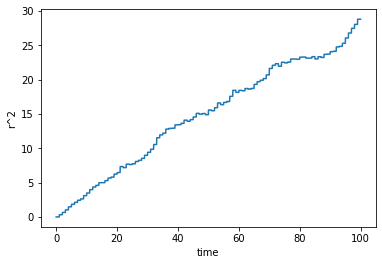

In [25]:
import seaborn as sns
# sns.lineplot(x='time', y='r^2', hue='particle', data=df, alpha=0.1)
df = simulate(N=100, num_jumps=1000)
sns.lineplot(x='time', y='r^2', data=df.groupby('time').mean().reset_index())

In [26]:
df = simulate(N=250, num_jumps=10000, temperature=2e-1, end_time=100, num_pts=1000)

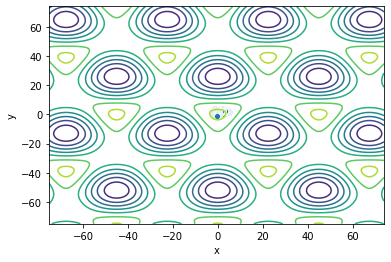

In [27]:
sns.scatterplot(x='x', y='y', data=df[df.particle < 2])
plt.contour(X, Y, Z)

In [133]:
from scipy.stats import linregress
from joblib import Parallel, delayed
from datetime import datetime, time

def generate_slope(**kwargs):
    df = simulate(**kwargs)
    tmp = df.groupby('time').mean().reset_index()
    t, r_squared = tmp['time'], tmp['r^2']
#     r_squared = np.log(r_squared[1:-1]).replace([np.inf, -np.inf], np.nan).dropna()
    slope, intercept, _, _, _ = linregress(r_squared.index, r_squared)
    return slope

now = datetime.now()
slopes = Parallel(n_jobs=8)(
            delayed(generate_slope)(N=100, num_jumps=1000, temperature=2e-1, end_time=100, num_pts=1000) for i in range(8)
        )
diff = datetime.now() - now
print (diff.seconds)

25


In [111]:
slopes

[0.030330695380346117,
 0.03191664847071042,
 0.032466405658343425,
 0.03298914530599602,
 0.03424852958247873,
 0.0334623447355183,
 0.029012143382291945,
 0.03326864141160076]

In [406]:
# jointplot = sns.jointplot(x='x', y='y', data=df, kind='hex', color='k',
#                          joint_kws = {'gridsize' : (300, 300)})
# x = np.arange(-100, 100, delta)
# y = np.arange(-100, 100, delta)
# X, Y = np.meshgrid(x, y)
# Z = Uc(X, Y)
# CS = jointplot.ax_joint.contour(X, Y, Z, alpha=0.2)
# jointplot.ax_joint.figure.set_size_inches(8, 8)
# jointplot.ax_joint.figure.set_dpi(200)
# jointplot.ax_joint.set_xlim(-100, 100)
# jointplot.ax_joint.set_ylim(-100, 100)

In [7]:
# from scipy.stats import expon, pareto
# from scipy.special import erfcx
# ax = sns.distplot(wait_times.ravel()[:50000], fit=expon, kde=False, norm_hist=True)
# sns.distplot(wait_times.ravel(), fit=expon, kde=False, ax=ax, norm_hist=True)
# ax.set_yscale('log')
# ax.set_xscale('log')
# x = np.linspace(0.01, 2e5, 1000)
# y = 2 * x ** -2
# plt.plot(x, y)

In [102]:
pareto.fit(wait_times.ravel()[wait_times.ravel() > 200])

NameError: name 'pareto' is not defined

Moire pattern size, moire potential height, temperature

In [127]:
NUM_MOIRE = 10
temps = np.linspace(1e-2, 5e-1, 10)
energy = np.linspace(1e-2, 5e-1, 10)
moire_period = np.linspace(1, 55, NUM_MOIRE)
temps, energy = np.meshgrid(temps, energy)
slopes = np.empty(temps.shape)
uncertainties = np.empty(temps.shape)
now = datetime.now()
print(slopes.shape)
for i in range(slopes.shape[0]):
    print(i)
    for j in range(slopes.shape[1]):
        runs = Parallel(n_jobs=8)(
            delayed(generate_slope)(N=100, num_jumps=10000, temperature=temps[i, j], trans_energy=energy[i, j], rotate_energy=energy[i,j] * 2 ,end_time=100, num_pts=1000) for _ in range(8)
        )
        slopes[i, j] = np.mean(runs)
        print(slopes[i, j])
        uncertainties[i, j] = np.std(runs)
        diff = datetime.now() - now
        print (diff.seconds)

(10, 10)
0
0.046978549299755035
4
0.062367177437521015
8
0.06274915613374159
12
0.05969883156049434
16
0.058987842970740834
20
0.0626555762025914
23
0.06316205125662648
27
0.06393110872797823
31
0.055591364803815296
35
0.06057132155502175
39
1
0.024627769470594356
44
0.047921084685131565
49
0.05699072058059373
53
0.05240721565248389
57
0.05633249202948015
61
0.05839550128592429
65
0.05803734812134807
69
0.05997389827516146
72
0.058982181293221074
76
0.05506323339492314
80
2
0.025672802561898425
85
0.036378955461136106
90
0.04180559428914151
94
0.047259767514413895
98
0.0509781973289257
102
0.056423691860465024
107
0.05914433602495281
111
0.05993359446257888
115
0.05780873395531251
119
0.05957485724235899
123
3
0.02611472884340047
128
0.028151422083073023
133
0.04051188814945737
137
0.046077221708973326
142
0.04938179325293937
146
0.05235921615966738
150
0.054720547167373235
154
0.0535516540296902
158
0.05318025536066681
162
0.05237154869928849
166
4
0.024318811463175917
171
0.028897866

Text(0, 0.5, 'energy_ratio')

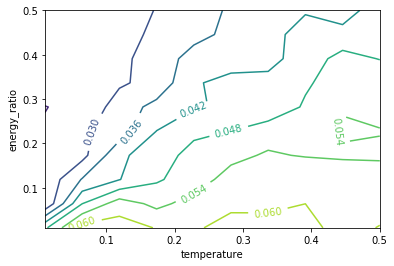

In [128]:
fig, ax = plt.subplots()
CS = ax.contour(temps, energy, slopes)
ax.clabel(CS, inline=1, fontsize=10)
ax.set_xlabel('temperature')
ax.set_ylabel('energy_ratio')

Text(0.5, 1.0, 'Diffusion Coefficient vs. Temperature and Transition Energy Values')

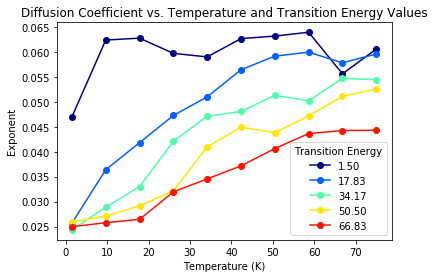

In [131]:
import matplotlib.pylab as pl
a = 0.246 # graphene lattice constant in angstrom
colors = pl.cm.jet(np.linspace(0,1,NUM_MOIRE))
for i in range(0, NUM_MOIRE, 2):
    plt.plot(temps[i] * 150, slopes[i], '-o',
                 label='{0:.2f}'.format(energy[i, 0] * 150),
                 color=colors[i])
plt.xlabel('Temperature (K)')
plt.ylabel('Exponent')
plt.legend(title='Transition Energy')
plt.title('Diffusion Coefficient vs. Temperature and Transition Energy Values')

In [150]:
C1 = 0.001
Uc = Phi(C0 / 2, C1, phi)
print(Uc(0, 0))
print(Uc(0, -lm * 2 / np.sqrt(3)))

-0.03077413152232515
-0.04051465168324032


In [292]:
3 / 0.24

12.5

In [ ]:
NUM_MOIRE = 5
abs_temps = np.linspace(1e-4, 5e-3, 20)
moire_amplitudes = np.linspace(1e-2, 5e-2, NUM_MOIRE)
abs_temps, moire_amplitudes = np.meshgrid(abs_temps, moire_amplitudes)
slopes = np.empty(abs_temps.shape)
uncertainties = np.empty(abs_temps.shape)
now = datetime.now()
for i in range(slopes.shape[0]):
    print(i)
    for j in range(slopes.shape[1]):
        lm = 45
        G1 = 4 * np.pi / (np.sqrt(3) * lm)
        C1 = moire_amplitudes[i, j]
        Uc = Phi(C0 / 2, C1, phi)
        U_delta = Uc(0, 0) - Uc(0, lm * 2 / np.sqrt(3))
        moire_amplitudes[i, j] = U_delta
        runs = Parallel(n_jobs=8)(
            delayed(generate_slope)(N=700, num_jumps=10000, temperature=None, end_time=100, num_pts=1000, abs_temp=abs_temps[i, j]) for _ in range(128)
        )
        slopes[i, j] = np.mean(runs)
        uncertainties[i, j] = np.std(runs)
diff = datetime.now() - now
print (diff.seconds)

0
1


Text(0.5, 1.0, 'Diffusion Exponent vs. Temperature and Moire Corrugation Energy')

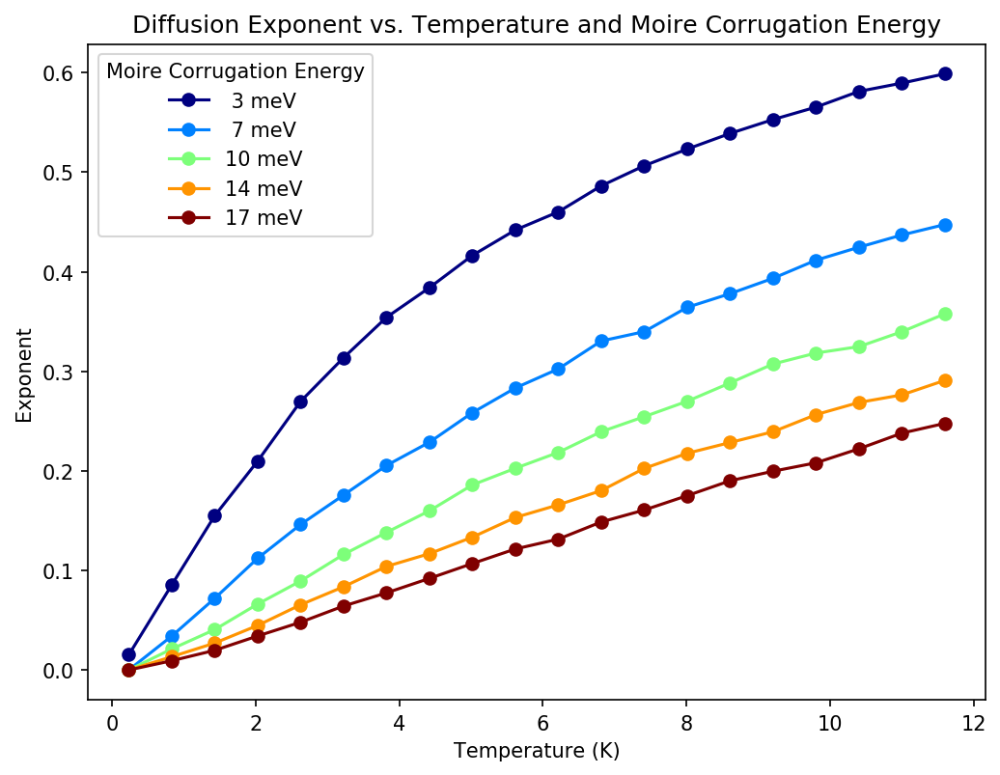

In [391]:
import matplotlib.pylab as pl
plt.figure(figsize=(8,6))
colors = pl.cm.jet(np.linspace(0,1,NUM_MOIRE)) 
for i in range(0, NUM_MOIRE):
    plt.plot(abs_temps[i] * 200 / 1000 * 1.16e4 , slopes[i], '-o',
                 label="{0:2.0f} meV".format(moire_amplitudes[i, 0] * 200),
                 color=colors[i])
plt.xlabel('Temperature (K)')
plt.ylabel('Exponent')
plt.legend(title='Moire Corrugation Energy')
plt.title('Diffusion Exponent vs. Temperature and Moire Corrugation Energy')

In [314]:
NUM_TRAJ = 25
NUM_PTS = 100
df = simulate(N=NUM_TRAJ, num_jumps=10000, temperature=2e-1, end_time=100, num_pts=NUM_PTS,)
df.head()

,x,y,particle,time,r^2
0,6.062178,-5.5,0,0.0,0.000000
1,5.773503,19.0,0,1.0,600.333333
2,7.505553,21.0,0,2.0,704.333333
3,9.526279,19.5,0,3.0,637.000000
4,5.196152,20.0,0,4.0,651.000000


Animation size has reached 21142271 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


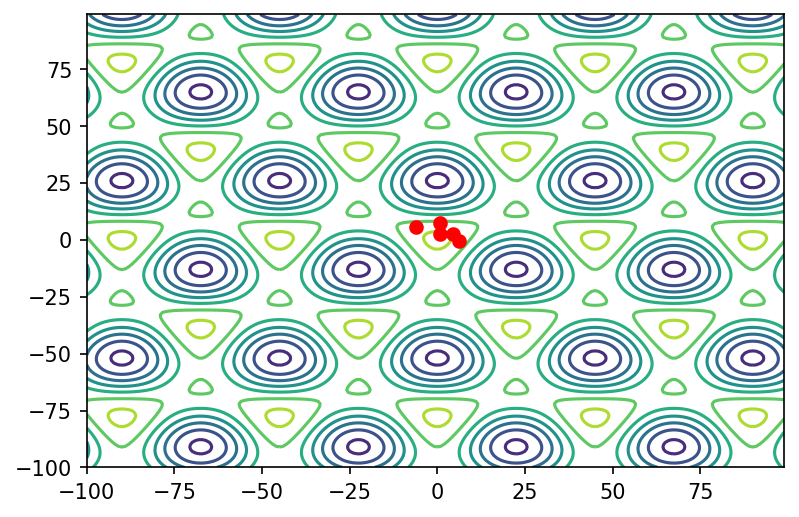

In [309]:
import matplotlib.animation
import matplotlib.pyplot as plt
import numpy as np
plt.rcParams["animation.html"] = "jshtml"
plt.rcParams['figure.dpi'] = 150  
plt.ioff()
fig, ax = plt.subplots()
trajs = df[['x', 'y']].to_numpy().reshape(NUM_TRAJ, NUM_PTS+1, 2)
def animate(i):
    plt.cla()
    plt.plot(trajs[:,i, 0].T, trajs[:,i, 1].T, 'ro') ## There are leeway in avoiding these costly transpositions
#             plt.plot(trajs[:,:i+1, 0].T, trajs[:,:i+1, 1].T)
    x = np.arange(-100, 100, 1)
    y = np.arange(-100, 100, 1)
    X, Y = np.meshgrid(x, y)
    Z = Uc(X, Y)
    CS = plt.contour(X, Y, Z)
# Set up formatting for the movie files
Writer = matplotlib.animation.writers['ffmpeg']
writer = Writer(fps=5, metadata=dict(artist='Me'), bitrate=1800)
line_ani = matplotlib.animation.FuncAnimation(fig, animate, frames=100)
line_ani.save('diffusing.mp4', writer=writer, dpi=150)

KeyboardInterrupt: 

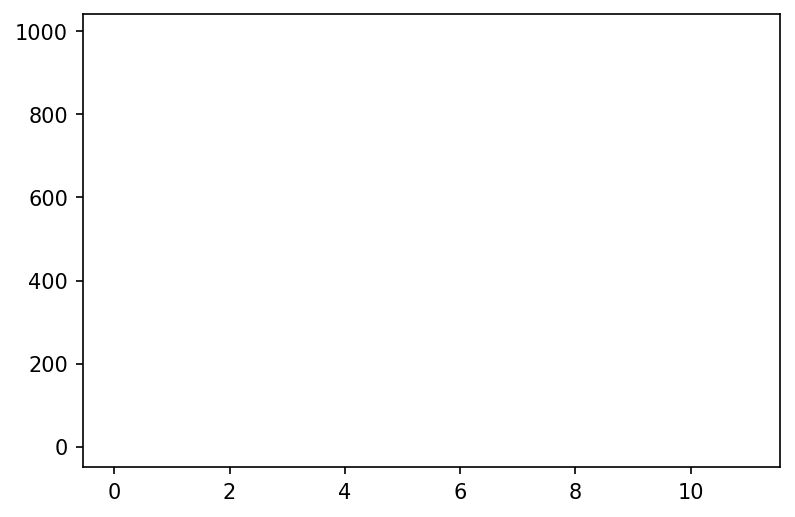

In [321]:
fig, ax = plt.subplots()
def animate(i):
    plt.cla()
    tmp = df[df.time < i]
    sns.lineplot(x='time', y='r^2', data=tmp, alpha=0.1)
    sns.lineplot(x='time', y='r^2', data=tmp.groupby('time').mean().reset_index(), label='MSD')
my_anim = matplotlib.animation.FuncAnimation(fig, animate, frames=100)

In [386]:
np.random.seed(0)
sub_df = simulate(N=1000, num_jumps=10000, temperature=4e-1, end_time=10000, num_pts=100,)
brown_df = simulate(N=1000, num_jumps=10000, temperature=1e3, end_time=10000, num_pts=100,)

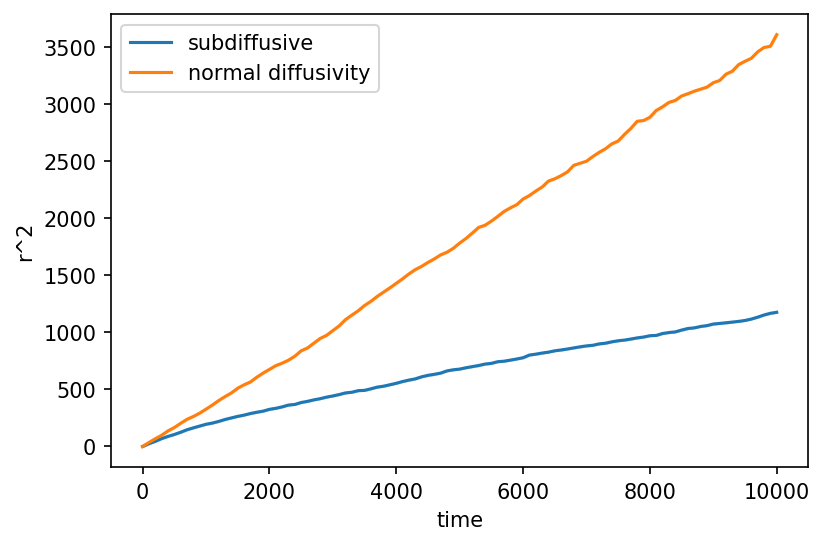

In [387]:
sns.lineplot(x='time', y='r^2', data=sub_df, alpha=1, label='subdiffusive', ci=0)
sns.lineplot(x='time', y='r^2', data=brown_df, alpha=1, label='normal diffusivity', ci=0)